Loading the Data

In [1]:
# Loading the data

from google.colab import drive
import pandas as pd
import numpy as np

drive.mount('/content/drive')

PO_data=pd.read_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/filtered_data_final_2.csv')

# Display the first few rows of the dataset
print('\n First few rows of the PO Dump: \n', PO_data.head(), '\n')

Mounted at /content/drive

 First few rows of the PO Dump: 
    Unnamed: 0  PO_NUM DOCCUR  DOCRATE SUPPLIER_CODE  \
0           0   53586    INR      1.0      VD001614   
1           1   53586    INR      1.0      VD001614   
2           2   53650    INR      1.0      VD003065   
3           3   53684    INR      1.0      VD003071   
4           4   53946    INR      1.0      VD002799   

                           SUPPLIER_NAME    DOC_DATE DELIVERY_DATE  \
0  ITG SOFTWARE ENGINEERING (I) PVT. LTD  01-10-2021    30-11-2022   
1  ITG SOFTWARE ENGINEERING (I) PVT. LTD  01-10-2021    30-11-2022   
2    TIKMANY TELESYSTEMS PRIVATE LIMITED  07-10-2021    28-09-2021   
3                       ZIP TECHNOLOGIES  08-10-2021    28-09-2021   
4          INSPIRED TECHNOLOGIES PVT LTD  18-10-2021    30-11-2021   

       PO_VALUE LOCATION  ...  TAX_AMOUNT(LC) LINETOTAL_WITH_TAX_(LC)  \
0  2.764740e+07      SEA  ...      410400.000            2.690400e+06   
1  2.764740e+07      SEA  ...     3807000

In [2]:
# Generate summary statistics
PO_data.describe()

,Unnamed: 0,PO_NUM,DOCRATE,PO_VALUE,ITEM_CODE_CLEANED,ORDERED_QUANTITY,PRICE,ITEM_VALUE,TAX_AMOUNT(LC),LINETOTAL_WITH_TAX_(LC),PART_ID_CLEANED,WIDTH_(MM),HEIGHT_(MM),DEPTH_(MM),MOUNTING_CLEARANCES_(MM),WEIGHT_(KG)
count,38972.000000,3.897200e+04,38972.000000,3.897200e+04,38972.000000,38972.000000,3.897200e+04,3.897200e+04,3.897200e+04,3.897200e+04,38972.000000,26996.000000,27064.000000,26245.000000,0.0,25417.000000
mean,19485.500000,1.326400e+08,11.108913,1.381926e+06,27336.907857,439.640368,1.643622e+04,1.295403e+05,1.955500e+04,1.490953e+05,27336.907857,347.839284,176.667481,78.847395,NaN,48.407351
std,11250.391682,1.156600e+08,27.008198,9.543567e+06,10356.347113,2366.380728,1.048510e+05,1.077163e+06,1.830149e+05,1.251052e+06,10356.347113,8427.289840,1528.398766,2990.158178,NaN,888.935567
min,0.000000,5.358600e+04,0.531900,0.000000e+00,14730.000000,1.000000,1.000000e-02,1.000000e-02,0.000000e+00,1.200000e-02,14730.000000,0.000000,0.000000,0.000000,NaN,0.000000
25%,9742.750000,7.353375e+04,1.000000,4.170651e+04,18060.000000,3.000000,7.050000e+01,2.250000e+03,2.088000e+02,2.596000e+03,18060.000000,0.000000,0.000000,0.000000,NaN,0.000000
50%,19485.500000,2.324308e+08,1.000000,1.489307e+05,26245.000000,12.000000,5.573750e+02,1.000000e+04,1.296000e+03,1.156400e+04,26245.000000,0.000000,5.000000,0.000000,NaN,0.000000
75%,29228.250000,2.324701e+08,1.000000,4.694166e+05,33073.000000,100.000000,3.750000e+03,4.433824e+04,6.466716e+03,5.160169e+04,33073.000000,48.000000,73.000000,52.000000,NaN,0.079000
max,38971.000000,2.425306e+08,105.572200,2.177792e+08,56001.000000,142000.000000,3.690000e+06,7.505000e+07,1.350900e+07,8.855900e+07,56001.000000,320000.000000,30000.000000,279400.000000,NaN,32100.000000


# Visualization

Top 10 Vendors

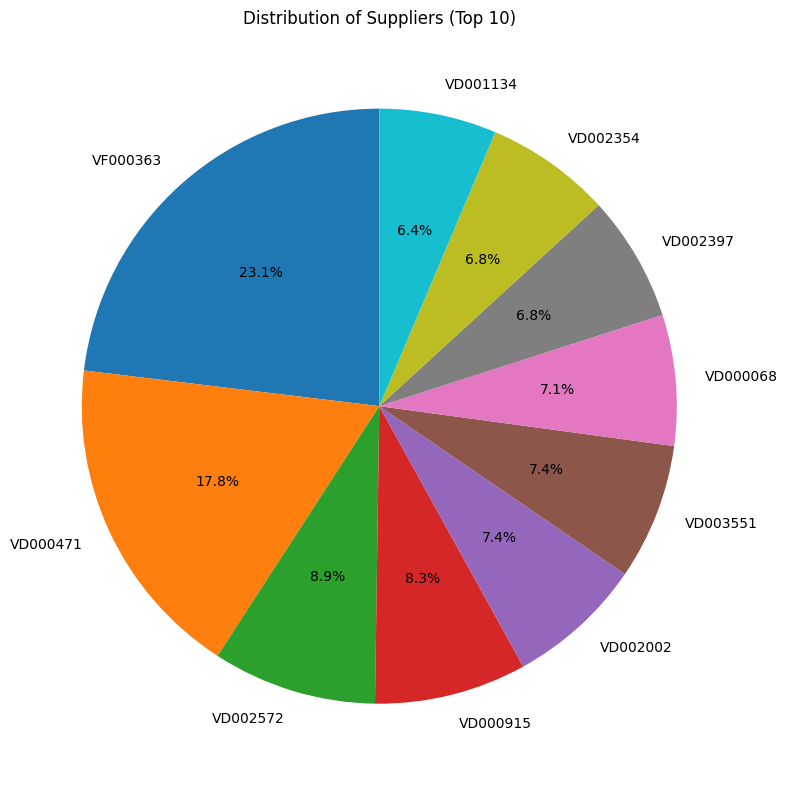

In [3]:
import matplotlib.pyplot as plt

# Calculate the frequency of each supplier
supplier_counts = PO_data['SUPPLIER_CODE'].value_counts()

# Select the top N suppliers for better visualization
top_n = 10
supplier_counts = supplier_counts.head(top_n)

# Plot the pie chart
plt.figure(figsize=(8, 8))
plt.pie(supplier_counts.values, labels=supplier_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Suppliers (Top {})'.format(top_n))
plt.axis('equal')
plt.tight_layout()
plt.show()

Distribution of Suppliers

Frequency = 1: VD001959, VF003700, VD002563, VF010061, VD001831, VF003665, VD000638, VF010017, VD000494, VF010026, VF010063, VD000442, VD001964, VD000395, VD002321, VF010069, VD002325, VD002328, VD002677, VF010019, VD002678, VCD000016, VF010022, VF010021, VF010028, VF010032, VD002505, VD000578, VF010007, VD002430, VF010031, VD000570, VD000555, VD002468, VF010033, VF010034, VF010012, VF003779, VF010035, VD002140, VF010038, VD002116, VD002114, VD002100, VD000596, VF010044, VD002421, VD002093, VF010047, VD002092, VD000672, VF003735, VD000606, VF010054, VD000604, VF010057, VD004026, VF010075, VO000093, VD000974, VO000102, VD001411, VO000099, VO000098, VO000097, VO000096, VO000095, VO000094, VO000092, VF010078, VO000091, VO000086, VD001510, VD000861, VO000082, VO000081, VO000080, VO000079, VD001514, VO000104, VO000105, VO000106, VO000108, VO000128, VO000127, VO000126, VO000125, VO000124, VD001246, VO000122, VD001247, VO000120, VO000119, VO000118, VO000117, VO000116, VD001253, VO000114, VO00

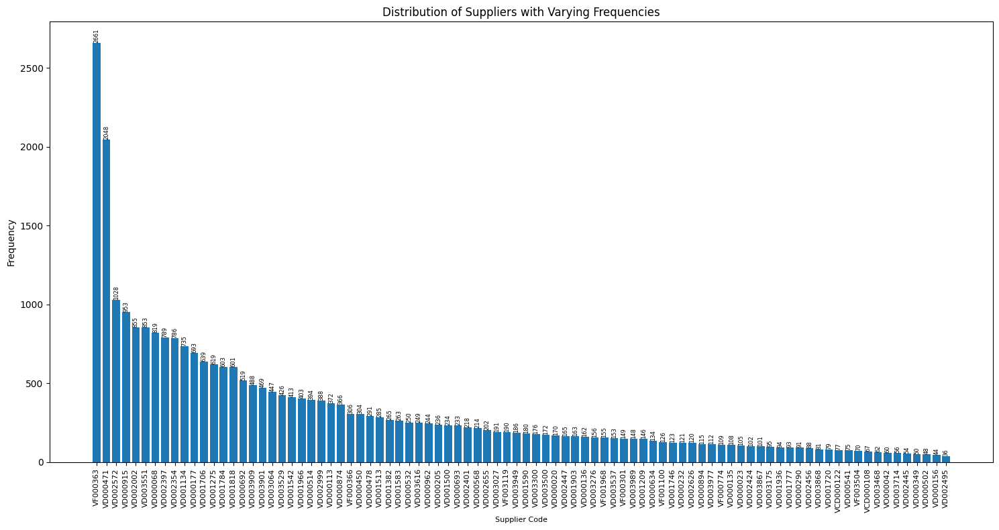

In [4]:
# Group data by 'SUPPLIER_CODE' and get the size of each group
supplier_counts = PO_data.groupby('SUPPLIER_CODE').size().reset_index(name='Frequency')

# Sort by frequency in descending order
supplier_counts = supplier_counts.sort_values(by=['Frequency'], ascending=False)

# Identify vendors with the same frequencies
frequency_counts = supplier_counts.groupby('Frequency').size().reset_index(name='Count')

# Filter out vendors with the same frequencies (Count > 1)
vendors_with_same_frequency = frequency_counts[frequency_counts['Count'] > 1]['Frequency'].unique()

# Concise list of vendors with the same frequencies
vendors_same_frequency_list = supplier_counts[supplier_counts['Frequency'].isin(vendors_with_same_frequency)]

# Group vendors by frequency and print in the desired format
for frequency, group in vendors_same_frequency_list.groupby('Frequency'):
    vendor_list = ', '.join(group['SUPPLIER_CODE'].tolist())
    print(f"Frequency = {frequency}: {vendor_list}")

# Filter out vendors with varying frequencies
vendors_varying_frequency = supplier_counts[~supplier_counts['Frequency'].isin(vendors_with_same_frequency)]

# Plot the vendors with varying frequencies
plt.figure(figsize=(15, 8))
bars = plt.bar(vendors_varying_frequency['SUPPLIER_CODE'], vendors_varying_frequency['Frequency'])
plt.title('Distribution of Suppliers with Varying Frequencies')
plt.xlabel('Supplier Code', fontsize=8)
plt.ylabel('Frequency')
plt.xticks(rotation=90, fontsize=8)  # Rotate x-axis labels for better readability

# Add data labels
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center', rotation=90, fontsize=6)

plt.tight_layout()
plt.show()

# Vendor Delivery Time Stats

In [9]:
# Convert 'DOC_CREATION_DATE' and 'DELIVERY_DATE' to datetime objects
PO_data['DOC_DATE'] = pd.to_datetime(PO_data['DOC_DATE'], format='%d-%m-%Y')
PO_data['DELIVERY_DATE'] = pd.to_datetime(PO_data['DELIVERY_DATE'])

# Calculate delivery time in days
PO_data['DELIVERY_TIME'] = (PO_data['DELIVERY_DATE'] - PO_data['DOC_DATE']).dt.days

PO_data['DELIVERY_TIME'] = PO_data['DELIVERY_TIME'].abs()

# Print delivery time for each vendor
print(PO_data[['SUPPLIER_CODE', 'DELIVERY_TIME']])

      SUPPLIER_CODE  DELIVERY_TIME
0          VD001614            425
1          VD001614            425
2          VD003065              9
3          VD003071             10
4          VD002799             43
...             ...            ...
38967      VD002002             11
38968      VD002002             11
38969      VD002002             11
38970      VD002002             11
38971      VD002002             11

[38972 rows x 2 columns]


In [10]:
#Print all vendors with negative delivery time
negative_delivery_time = PO_data[PO_data['DELIVERY_TIME'] < 0]

#Total number of vendors with negative delivery date
print('Total Number of vendors with Negative deliveries:', len(negative_delivery_time['SUPPLIER_CODE'].unique()), '\n')
print(negative_delivery_time['SUPPLIER_CODE'].value_counts())

Total Number of vendors with Negative deliveries: 0 

Series([], Name: count, dtype: int64)


In [12]:
# Group by vendor and calculate delivery time statistics
vendor_delivery_times = PO_data.groupby('SUPPLIER_CODE')['DELIVERY_TIME'].agg(['mean', 'median', 'std'])

# Print or further analyze the delivery time statistics for each vendor
print(vendor_delivery_times)

                     mean  median        std
SUPPLIER_CODE                               
VCD000001       59.000000    59.0   0.000000
VCD000011      165.000000   165.0   0.000000
VCD000012       23.000000    23.0   0.000000
VCD000016       80.000000    80.0        NaN
VCD000018      131.000000   131.0        NaN
...                   ...     ...        ...
VO000127         4.000000     4.0        NaN
VO000128         4.000000     4.0        NaN
VO000129         2.000000     2.0   0.000000
VRD000116        1.333333     1.0   0.577350
VRD010001       77.400000    93.0  32.887688

[1133 rows x 3 columns]


Categorizing Vendors on the basis of Delivery times and storing in a .csv file

In [13]:
min_days = 7
max_days = 31

# Create empty dictionaries to store the results
less_than_min_days = {}
between_min_and_max_days = {}

# Group data by PART_NAME
for part_name, part_data in PO_data.groupby('PART_NAME'):
    less_than_min_days[part_name] = []
    between_min_and_max_days[part_name] = []

    # Iterate through each vendor for the current PART_NAME
    for supplier_code, supplier_data in part_data.groupby('SUPPLIER_CODE'):
        delivery_times = supplier_data['DELIVERY_TIME'].dropna().tolist()
        if delivery_times:
            if all(dt <= min_days for dt in delivery_times):
                less_than_min_days[part_name].append(supplier_code)
            elif all(min_days < dt <= max_days for dt in delivery_times):
                between_min_and_max_days[part_name].append(supplier_code)

# Create a DataFrame to store the results
results_df = pd.DataFrame(columns=['PART_NAME', 'Less_than_min_days', 'Between_min_and_max_days'])

for part_name in less_than_min_days:
    results_df = pd.concat([results_df, pd.DataFrame({'PART_NAME': [part_name],
                                                     'Less_than_min_days': [less_than_min_days.get(part_name, [])],
                                                     'Between_min_and_max_days': [between_min_and_max_days.get(part_name, [])]})], ignore_index=True)


# Store the results in a CSV file
results_df.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/vendor_categories.csv', index=False)

results_df

,PART_NAME,Less_than_min_days,Between_min_and_max_days
0,0.25 SQ/MM WIRE WHITE/BLUE,"[VD002447, VD003551, VF000363]","[VD000177, VD001134, VD001784]"
1,"0.5 SQ.MM SINGLE CORE CABLE - BLUE, LAPP",[VD003909],"[VD001571, VD001784]"
2,0.5 SQ.MM WIRE - WHITE (FRLS),[VD003977],"[VD000177, VD001784, VD003909]"
3,0.5 SQ/MM WIRE WHITE/BLUE,[VF000363],"[VD002572, VD003027, VD004245]"
4,0.75 SQ/MM WIRE WHITE/BLUE,"[VD000084, VD002447, VD002845, VD003551, VF000...","[VD001134, VD001784, VD002002, VD002572, VD003..."
...,...,...,...
1990,"WIRELESS ESTOP-WOL,SELF M,TX,1CH",[VD000915],"[VD001767, VD002572]"
1991,WIRING DUCT 25*45,"[VD002397, VD003551]","[VD000471, VD001583, VD003205, VD003909]"
1992,Y CONNECTOR,[VD000068],[]
1993,Y-LINK FOR CONNECTION OF SINGLE-CHANNEL DP SLA...,[],"[VCD000125, VD000962, VD003175, VF001976, VF00..."


Visualizing min max delivery time for each vendor

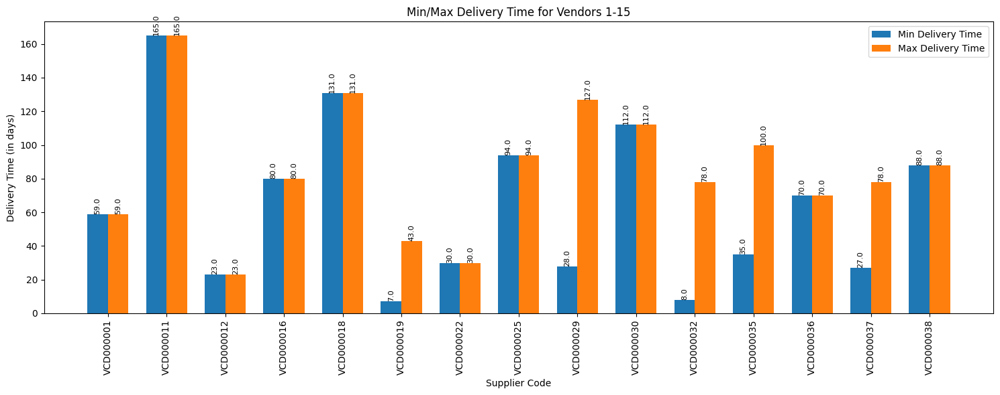

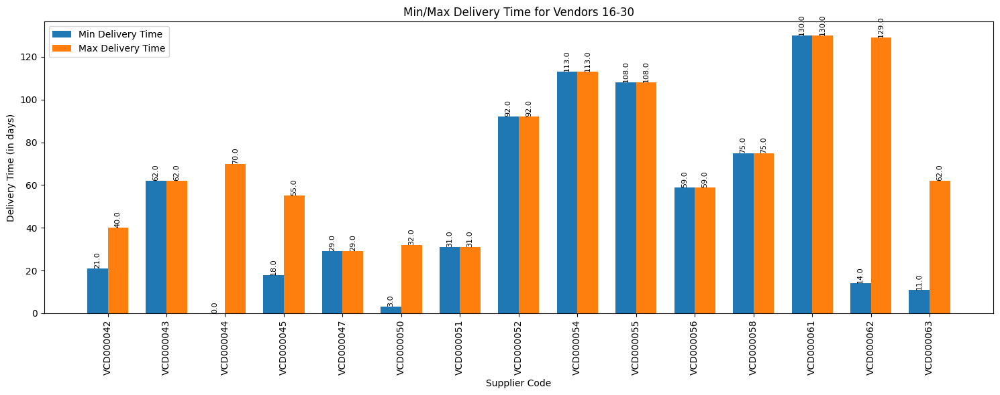

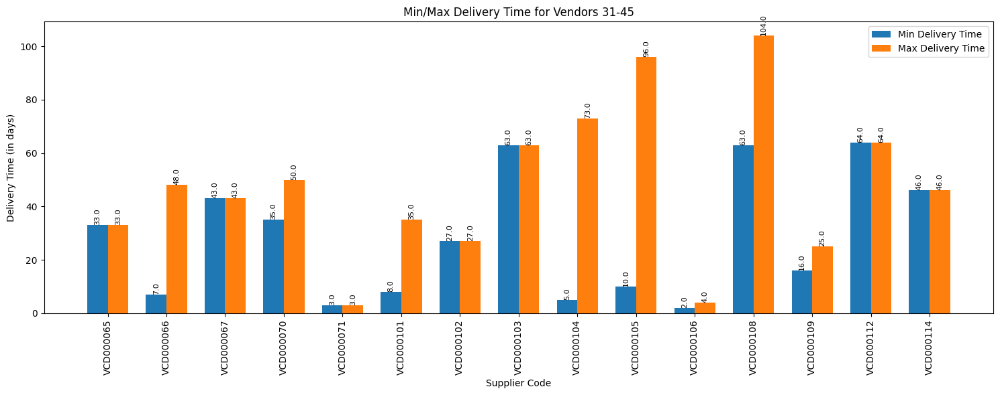

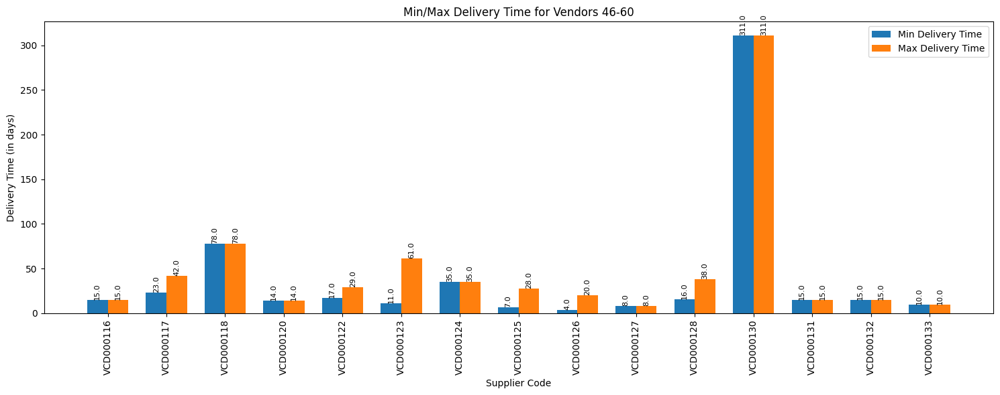

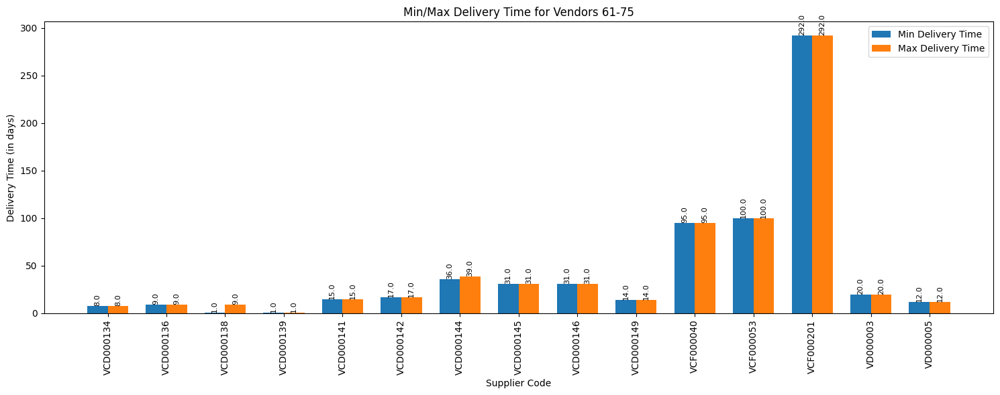

...

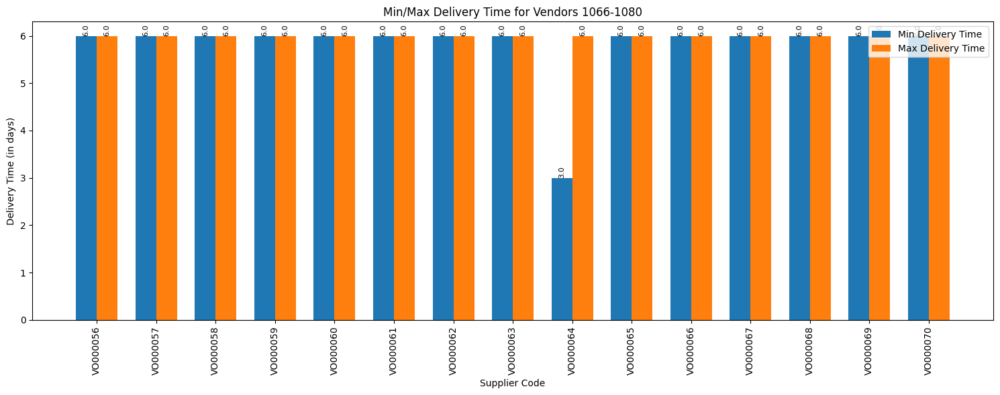

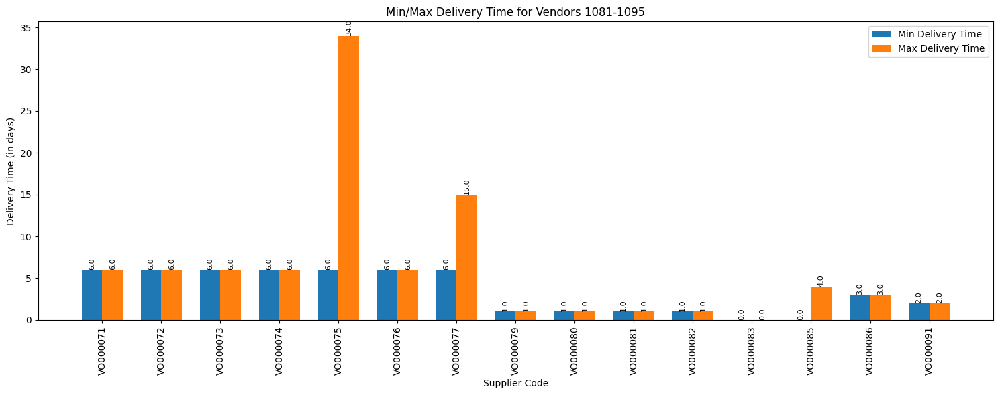

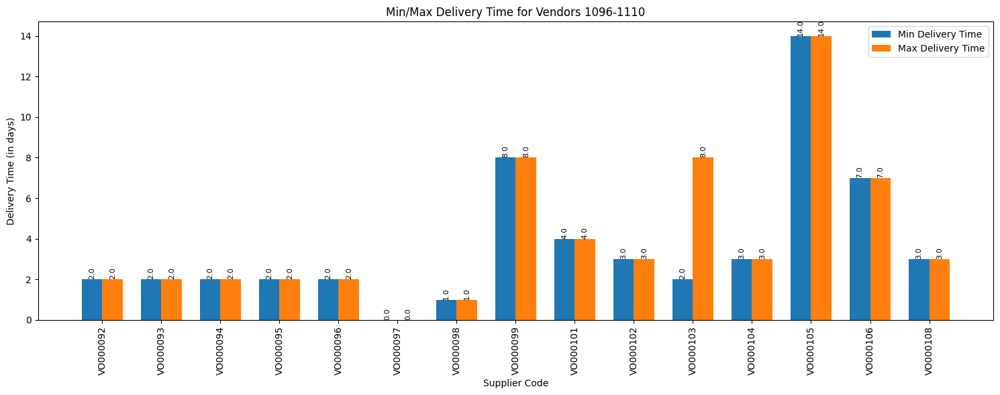

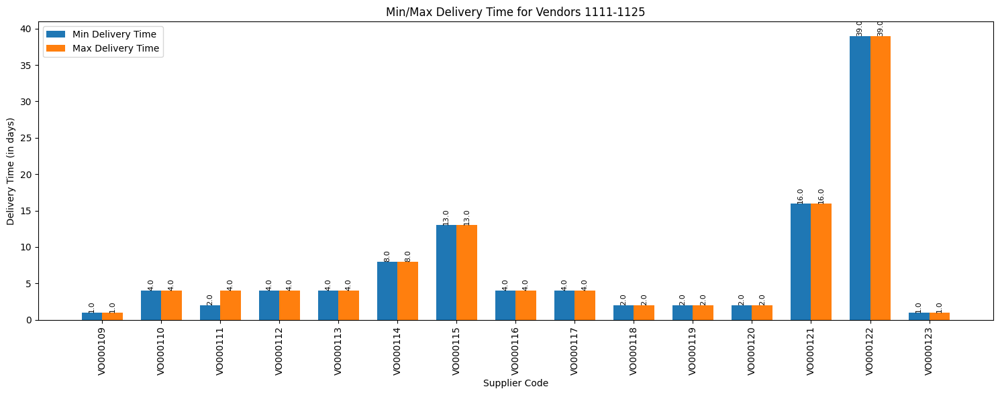

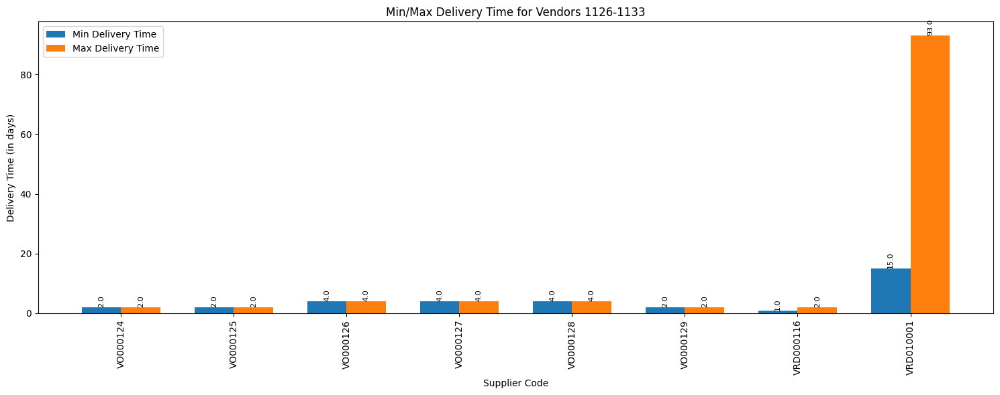

In [14]:
# Group data by 'SUPPLIER_CODE' and calculate min/max delivery time
vendor_delivery_times = PO_data.groupby('SUPPLIER_CODE')['DELIVERY_TIME'].agg(['min', 'max'])

# Reset the index to make 'SUPPLIER_CODE' a column
vendor_delivery_times = vendor_delivery_times.reset_index()

# Define the number of vendors per graph
vendors_per_graph = 15

# Calculate the number of graphs needed
num_graphs = int(np.ceil(len(vendor_delivery_times) / vendors_per_graph))

# Create subplots for each graph
for i in range(num_graphs):
  start_index = i * vendors_per_graph
  end_index = min((i + 1) * vendors_per_graph, len(vendor_delivery_times))

  graph_data = vendor_delivery_times.iloc[start_index:end_index]

  # Create a figure and axes for the double bar graph
  fig, ax = plt.subplots(figsize=(15, 6))

  # X-axis labels (supplier codes)
  x_labels = graph_data['SUPPLIER_CODE'].tolist()

  # Create bar positions for min and max delivery times
  x = np.arange(len(x_labels))
  width = 0.35

  # Plot the bars for min delivery time
  ax.bar(x - width / 2, graph_data['min'], width, label='Min Delivery Time')

  # Plot the bars for max delivery time
  ax.bar(x + width / 2, graph_data['max'], width, label='Max Delivery Time')

  # Add data labels
  for bar in ax.patches:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width() / 2., height,
                f'{height:.1f}', ha='center', va='bottom', fontsize=8, rotation=90)

  # Customize the graph
  ax.set_title(f'Min/Max Delivery Time for Vendors {start_index + 1}-{end_index}')
  ax.set_xlabel('Supplier Code')
  ax.set_ylabel('Delivery Time (in days)')
  ax.set_xticks(x)
  ax.set_xticklabels(x_labels, rotation=90)
  ax.legend()

  plt.tight_layout()
  plt.show()

Getting a list of vendors having a lead time greater than 31 days and storing in a .csv file

In [ ]:
# Group data by 'SUPPLIER_CODE' and calculate min/max delivery time
vendor_delivery_times = PO_data.groupby('SUPPLIER_CODE')['DELIVERY_TIME'].agg(['min', 'max'])

# Reset the index to make 'SUPPLIER_CODE' a column
vendor_delivery_times = vendor_delivery_times.reset_index()

# Save the DataFrame to a CSV file
vendor_delivery_times.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/vendor_delivery_times.csv', index=False)

In [ ]:
# Filter data for delivery time greater than or equal to 31 days
filtered_data = PO_data[PO_data['DELIVERY_TIME'] >= 31]

# Get the list of PART_NAME with the required details
Extra_High_Lead_Parts = filtered_data[['PART_ID_CLEANED', 'PART_NAME', 'PART_DESCRIPTION', 'SUPPLIER_NAME', 'SUPPLIER_CODE', 'PRICE', 'DELIVERY_TIME']].drop_duplicates()

# Display the list
print('Extra High Lead Parts: \n', Extra_High_Lead_Parts, '\n')

#Store in a CSV file
Extra_High_Lead_Parts.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/Extra_High_Lead_Parts.csv', index=False)

Extra High Lead Parts: 
        PART_ID_CLEANED                                    PART_NAME  \
0                17306                                      SENSORS   
1                17340                        SINGLE BOARD COMPUTER   
4                17448                                       SENSOR   
6                17360  FEMALE CONNECTOR M12 STRAIGHT A-CODED 8-PIN   
7                17365      CAMERA BASEDD LINEAR POSITIONING SENSOR   
...                ...                                          ...   
38941            50340   CONNECTOR-10P,FEMALE,6A,0.5SQMM,LIGHT GREY   
38942            55993                            CONTROLLER-24V DC   
38943            55994                            CONTROLLER-24V DC   
38944            56001    CONNECTOR-3P,FEMALE,10A,1.5 MM2,LICHTGRAU   
38950            17683                                    CONNECTOR   

                                        PART_DESCRIPTION  \
0                        MINIATURE PHOTOELECTRIC SENSORS   
1 

Getting a list of vendors having a lead time less than or equal to 7 days and storing in a .csv file

In [ ]:
# Filter data for delivery time less than or equal to 7 days
filtered_data = PO_data[PO_data['DELIVERY_TIME'] <= 7]

# Get the list of PART_NAME with the required details
Low_Lead_Parts = filtered_data[['PART_ID_CLEANED', 'PART_NAME', 'PART_DESCRIPTION', 'SUPPLIER_NAME', 'SUPPLIER_CODE', 'PRICE', 'DELIVERY_TIME']].drop_duplicates()

# Display the list
print('Low Lead Parts: \n', Low_Lead_Parts, '\n')

#Store in a CSV file
Low_Lead_Parts.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/Low_Lead_Parts.csv', index=False)

Low Lead Parts: 
        PART_ID_CLEANED                                   PART_NAME  \
2                28317                                   CONNECTOR   
3                18181                                    PLC CARD   
30               29092                             BARCODE SCANNER   
31               45924   ENCLOSURE-PDP, 2025X1900X400, FLOOR MOUNT   
104              14985                                        LUGS   
...                ...                                         ...   
38895            18968                                   MCB-1P,2A   
38896            24271                              MPCB-3P,13-18A   
38898            38435        CONDUIT GLAND-POLYAMIDE CABLE ,PG 11   
38899            38437  CONDUIT PIPE-PLASTIC,11.8MM,FLEXIBLE,BLACK   
38952            29706                                     GROMMET   

                                        PART_DESCRIPTION  \
2                     CONNECTION LINE YM2D24-050PN1MRJA4   
3                    

Getting a list of vendors having a lead time greater than 7 days and less than or equal to 31 days and storing in a .csv file

In [ ]:
# Filter the data based on delivery time
filtered_data = PO_data[(PO_data['DELIVERY_TIME'] <= 31) & (PO_data['DELIVERY_TIME'] > 7)]

# Get the list of PART_NAME with the specified condition
High_Lead_Parts = filtered_data[['PART_ID_CLEANED', 'PART_NAME', 'PART_DESCRIPTION', 'SUPPLIER_NAME', 'SUPPLIER_CODE', 'PRICE', 'DELIVERY_TIME']].drop_duplicates()

# Display the list
print('High Lead Parts: \n', High_Lead_Parts, '\n')

#Store in a CSV file
High_Lead_Parts.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/High_Lead_Parts.csv', index=False)

High Lead Parts: 
        PART_ID_CLEANED                                   PART_NAME  \
5                33726                         HMI-10.1",TOUCH,24V   
25               18308                                       DRIVE   
26               22818                              FEMALE HARNESS   
166              14976                              CONNECTOR-RJ45   
167              26986                                     BATTERY   
...                ...                                         ...   
38967            18854                                       CABLE   
38968            24575                                         LUG   
38969            25399                        PG9 WASHER FOR GLAND   
38970            26718                                      DM TAG   
38971            43015  END COVER <DASH> TERMINALS, 4 SQMM/10 SQMM   

                                        PART_DESCRIPTION  \
5                            SIMATIC HMI MTP1000 UNIFIED   
25      400 WATT SER

# Vendor Price Analysis

Getting a list of parts with min and max price along with vendor details

In [ ]:
# Group by PART_NAME and find the min and max price for each part
part_price_range = PO_data.groupby(['PART_NAME'])['PRICE'].agg(['min', 'max'])

# Reset the index to make PART_NAME a column
part_price_range = part_price_range.reset_index()

# Merge with the original data to get the supplier name for min and max price
min_price_suppliers = PO_data.loc[PO_data.groupby(['PART_NAME'])['PRICE'].idxmin()][['PART_ID_CLEANED', 'PART_NAME', 'SUPPLIER_NAME', 'SUPPLIER_CODE', 'PRICE', 'DELIVERY_TIME']]
max_price_suppliers = PO_data.loc[PO_data.groupby(['PART_NAME'])['PRICE'].idxmax()][['PART_ID_CLEANED', 'PART_NAME', 'SUPPLIER_NAME', 'SUPPLIER_CODE', 'PRICE', 'DELIVERY_TIME']]


# Rename columns for clarity
min_price_suppliers = min_price_suppliers.rename(columns={'SUPPLIER_NAME': 'SUPPLIER_NAME_Min', 'PRICE': 'PRICE_Min'})
max_price_suppliers = max_price_suppliers.rename(columns={'SUPPLIER_NAME': 'SUPPLIER_NAME_Max', 'PRICE': 'PRICE_Max'})


# Merge min and max price suppliers with part price range
result_df = pd.merge(part_price_range, min_price_suppliers, on='PART_NAME', how='left')
result_df = pd.merge(result_df, max_price_suppliers, on='PART_NAME', how='left')

#Drop PART_ID_CLEANED_y
result_df = result_df.drop(columns=['min', 'max', 'PART_ID_CLEANED_y'])

#Rename PART_ID_CLEANED_x
result_df = result_df.rename(columns={'PART_ID_CLEANED_x': 'PART_ID_CLEANED', 'DELIVERY_TIME_x': 'DELIVERY_TIME_Min', 'DELIVERY_TIME_y': 'DELIVERY_TIME_Max', 'SUPPLIER_CODE_x': 'SUPPLIER_CODE_Min', 'SUPPLIER_CODE_y': 'SUPPLIER_CODE_Max'})

#Drop min and max
#result_df = result_df.drop(columns=['min', 'max'])

#Re-arrage the columns
result_df = result_df[['PART_ID_CLEANED', 'PART_NAME', 'SUPPLIER_CODE_Min', 'SUPPLIER_NAME_Min', 'PRICE_Min','DELIVERY_TIME_Min','SUPPLIER_CODE_Max', 'SUPPLIER_NAME_Max', 'PRICE_Max', 'DELIVERY_TIME_Max']]

# Display the result
print(result_df)

# Store the results in a CSV file
result_df.to_csv('/content/drive/MyDrive/NUS-ISS AIS Projects/Project 1/Data/part_price_range_with_supplier.csv', index=False)

      PART_ID_CLEANED                                          PART_NAME  \
0               17799                         0.25 SQ/MM WIRE WHITE/BLUE   
1               18776           0.5 SQ.MM SINGLE CORE CABLE - BLUE, LAPP   
2               18780                      0.5 SQ.MM WIRE - WHITE (FRLS)   
3               17798                          0.5 SQ/MM WIRE WHITE/BLUE   
4               17802                         0.75 SQ/MM WIRE WHITE/BLUE   
...               ...                                                ...   
1990            37857                   WIRELESS ESTOP-WOL,SELF M,TX,1CH   
1991            27057                                  WIRING DUCT 25*45   
1992            28316                                        Y CONNECTOR   
1993            24230  Y-LINK FOR CONNECTION OF SINGLE-CHANNEL DP SLA...   
1994            15011                        YELLOW WIRE/CABLE 0.75 SQMM   

     SUPPLIER_CODE_Min                          SUPPLIER_NAME_Min  PRICE_Min  \
0      

Visualizing min and max price for each part

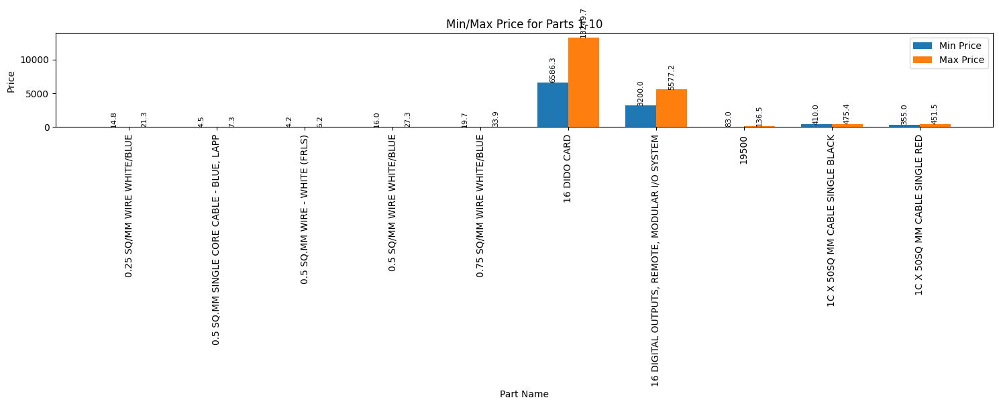

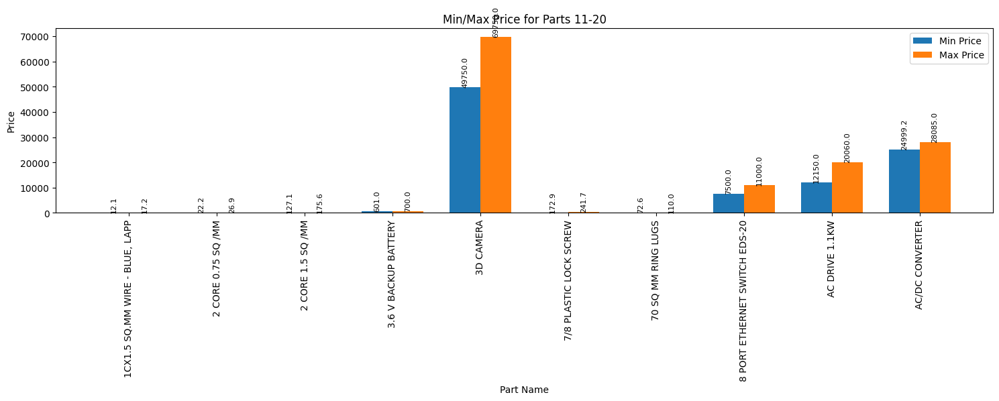

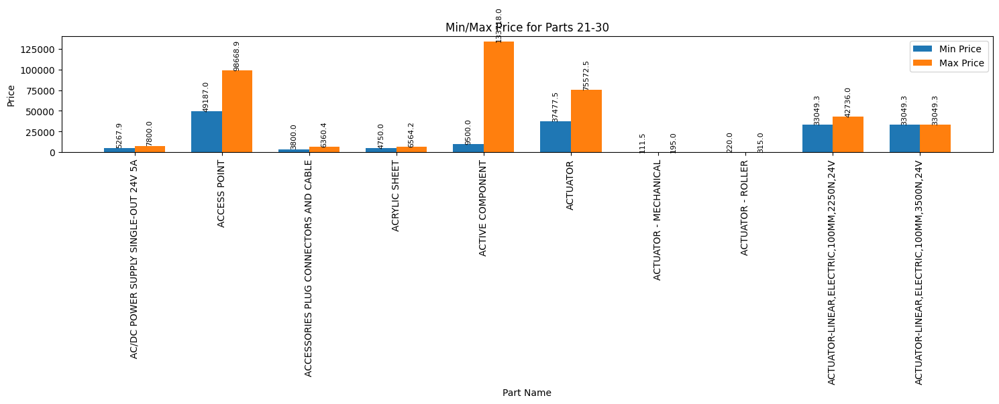

<ipython-input-56-95b93721192d>:44: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


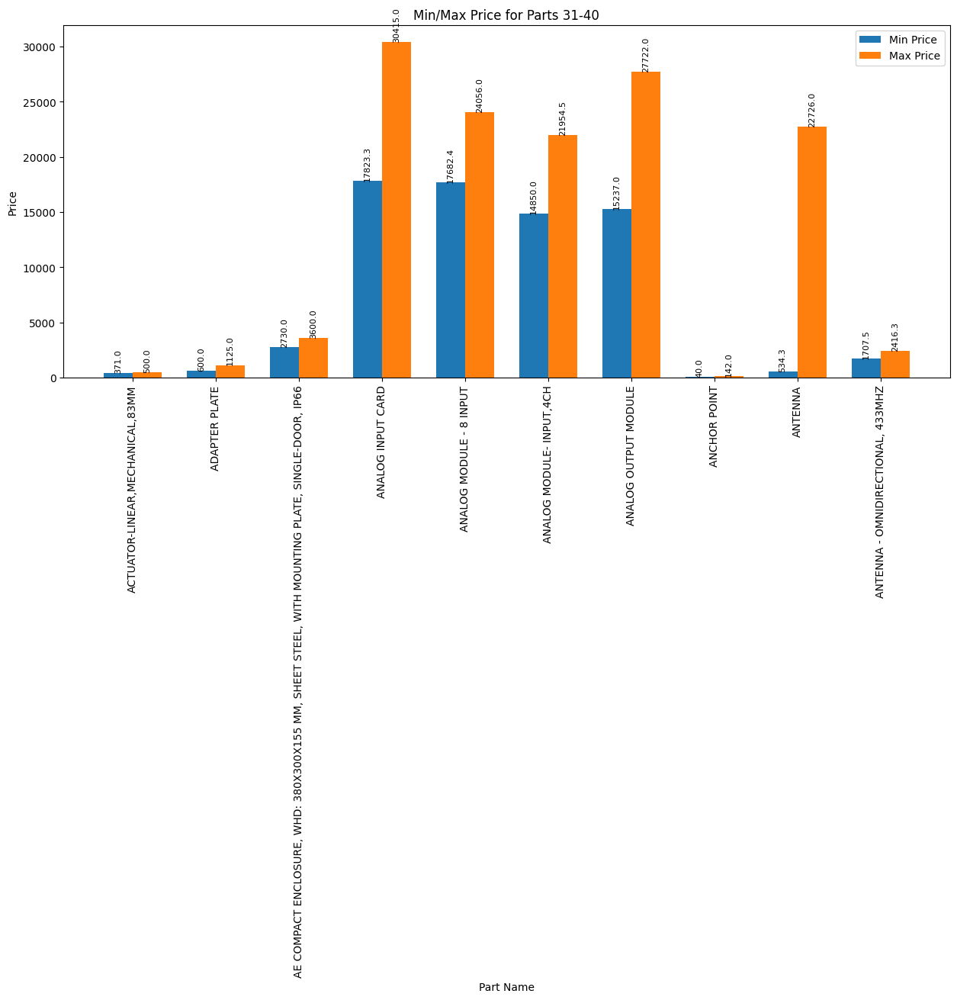

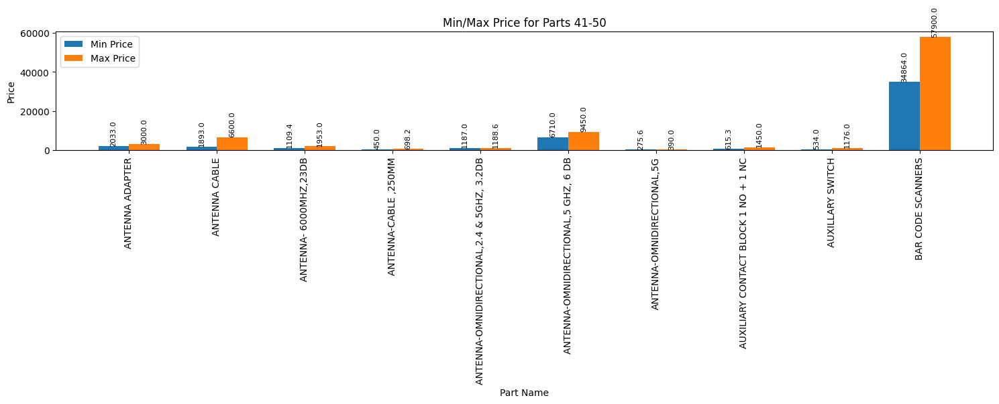

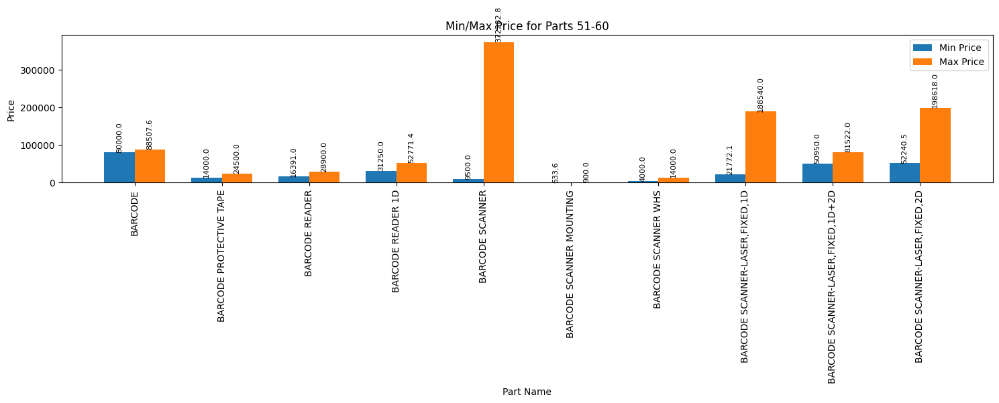

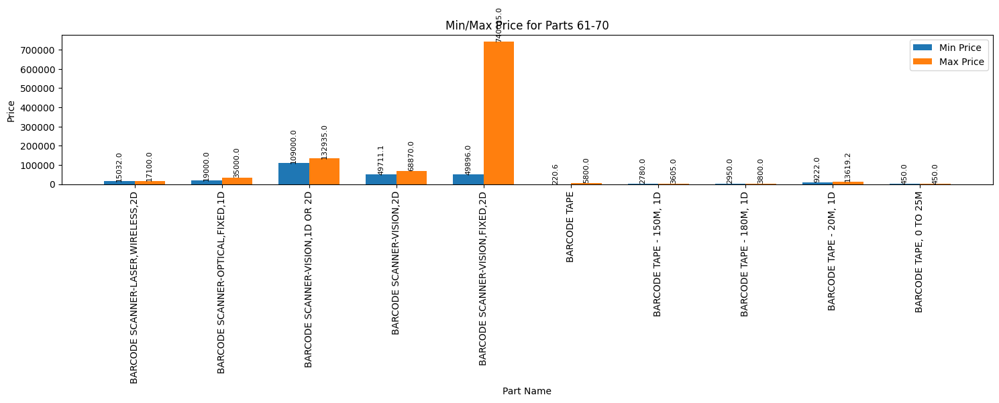

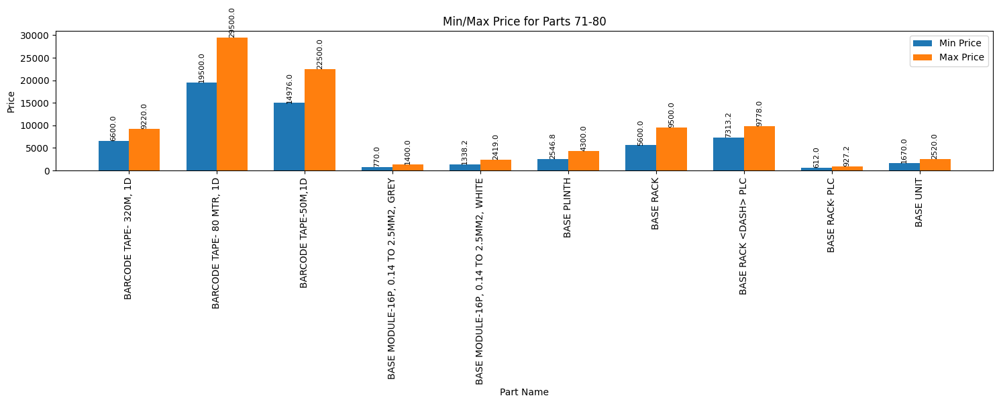

...

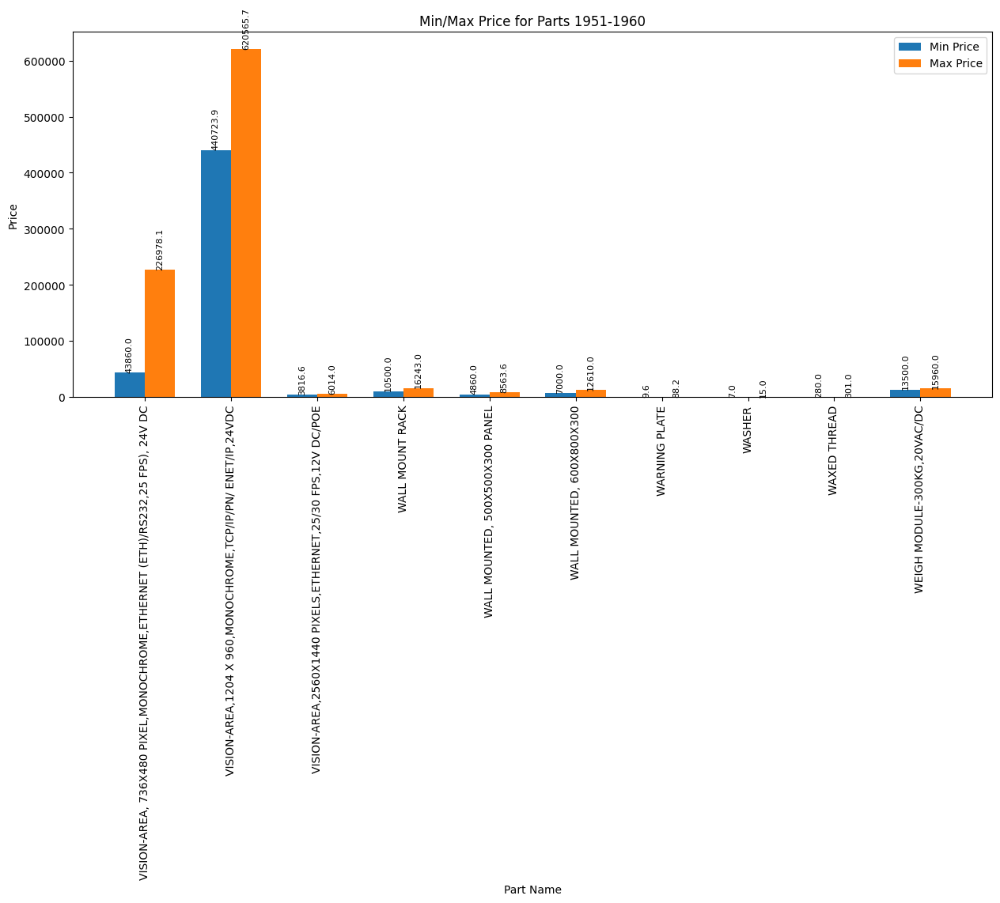

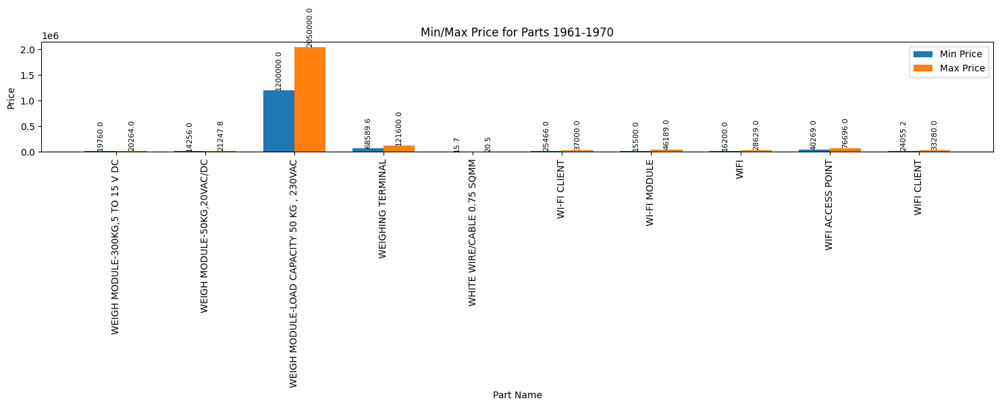

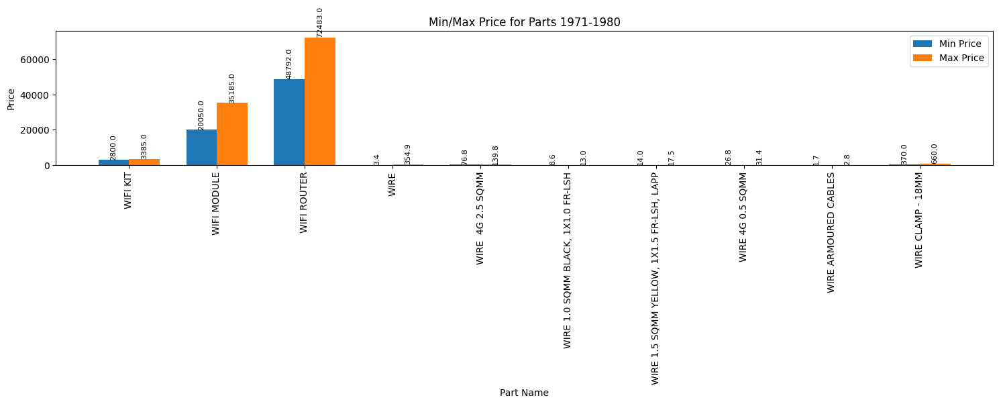

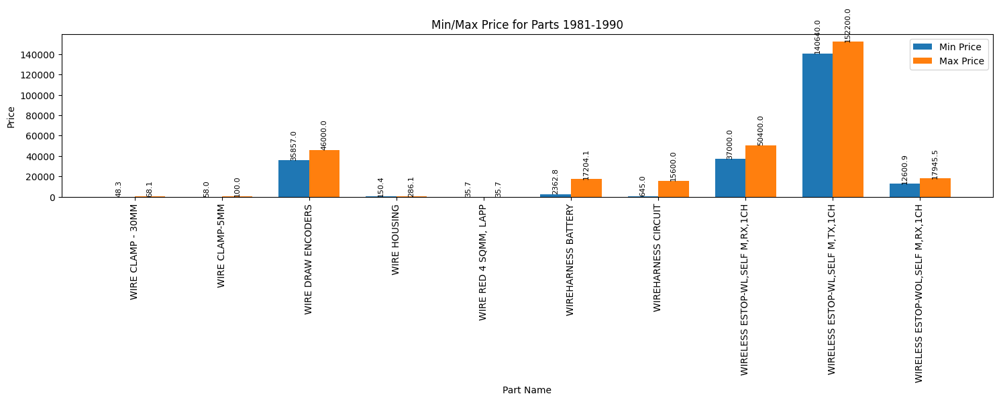

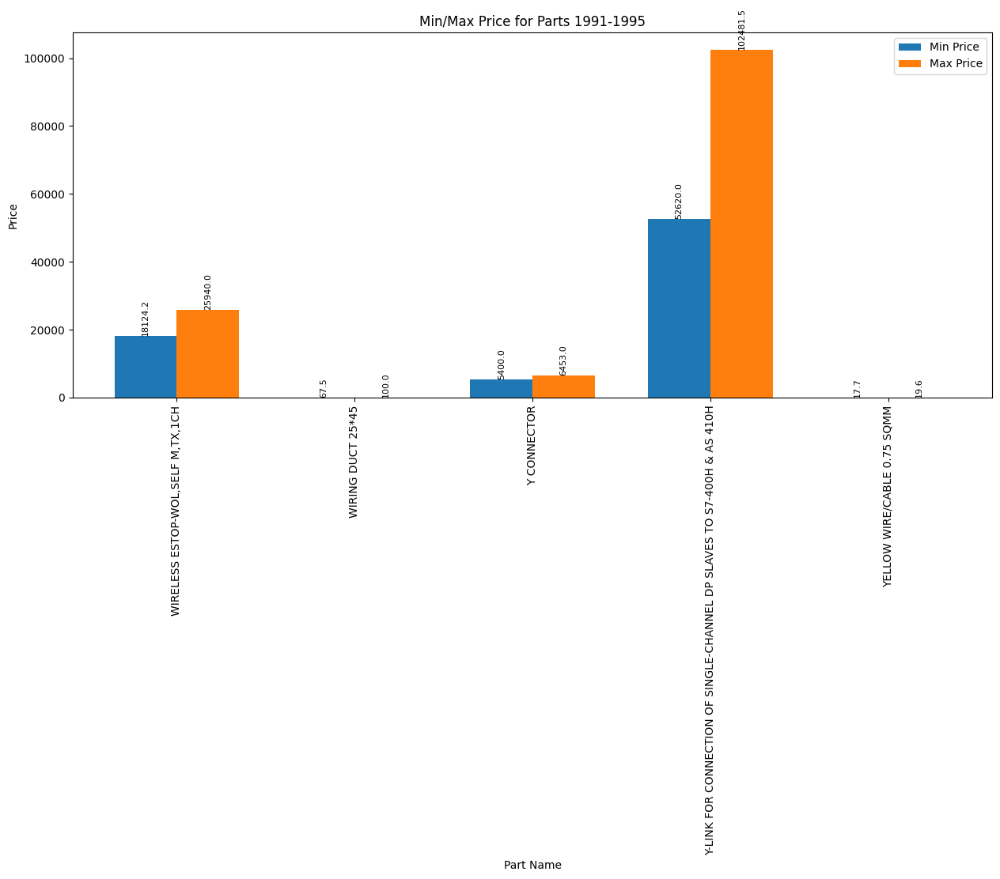

In [ ]:
# Number of parts to visualize per subplot
parts_per_subplot = 10

# Calculate the number of subplots needed
num_subplots = int(np.ceil(len(result_df) / parts_per_subplot))

# Loop through each subplot
for i in range(num_subplots):
  start_index = i * parts_per_subplot
  end_index = min((i + 1) * parts_per_subplot, len(result_df))

  subplot_data = result_df.iloc[start_index:end_index]

  # Create a figure and axes for the double bar graph
  fig, ax = plt.subplots(figsize=(15, 6))

  # X-axis labels (PART_NAME)
  x_labels = subplot_data['PART_NAME'].tolist()

  # Create bar positions for min and max prices
  x = np.arange(len(x_labels))
  width = 0.35

  # Plot the bars for min price
  ax.bar(x - width / 2, subplot_data['PRICE_Min'], width, label='Min Price')

  # Plot the bars for max price
  ax.bar(x + width / 2, subplot_data['PRICE_Max'], width, label='Max Price')

  # Add data labels
  for bar in ax.patches:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width() / 2., height,
            f'{height:.1f}', ha='center', va='bottom', fontsize=8, rotation=90)

  # Customize the graph
  ax.set_title(f'Min/Max Price for Parts {start_index + 1}-{end_index}')
  ax.set_xlabel('Part Name')
  ax.set_ylabel('Price')
  ax.set_xticks(x)
  ax.set_xticklabels(x_labels, rotation=90)
  ax.legend()

  plt.tight_layout()
  plt.show()

# Ranking and Scoring of Vendors based on Delivery time and Price

Ranking Vendors on the basis of Price

In [ ]:
part_id = PO_data['PART_NAME'].sample().iloc[0]  # Randomly selecting for now

# Filter the data for the specific part ID
part_data = PO_data[PO_data['PART_NAME'] == part_name]

# Sort the data by price in ascending order
ranked_vendors = part_data.sort_values('PRICE')

# Display the relevant columns: Supplier ID, Name, Delivery time, Price
result = ranked_vendors[['PART_ID_CLEANED', 'PART_NAME', 'SUPPLIER_CODE', 'SUPPLIER_NAME', 'DELIVERY_TIME', 'PRICE']]
result

,PART_ID_CLEANED,PART_NAME,SUPPLIER_CODE,SUPPLIER_NAME,DELIVERY_TIME,PRICE
9112,18708,"MCB-2P,4A",VD000177,GOLDEN TRADERS,14,380.00
16189,18708,"MCB-2P,4A",VD002401,SD ELECTRICAL,14,455.00
19863,18708,"MCB-2P,4A",VD002401,SD ELECTRICAL,15,455.00
14419,18708,"MCB-2P,4A",VD001821,THE ROLLER BEARING CO (DELHI),21,460.00
1288,18708,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,344,460.98
...,...,...,...,...,...,...
2670,17494,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,84,3796.10
3435,17494,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,49,3796.10
12020,17494,"MCB-2P,4A",VF000363,DIGI-KEY ELECTRONICS.,6,4050.59
21459,17494,"MCB-2P,4A",VD001818,ABC TECHNOLOGIES,7,4500.00


Scoring Vendors out of 10 based on Delivery Times

In [ ]:
# Group data by supplier and calculate the average delivery time
average_delivery_time_by_vendor = PO_data.groupby('SUPPLIER_CODE')['DELIVERY_TIME'].mean()

# Normalize the average delivery time to a score out of 10
def normalize_delivery_time_score(delivery_time):
  """Normalizes delivery time to a score between 0 and 10."""
  min_delivery_time = PO_data['DELIVERY_TIME'].min()
  max_delivery_time = PO_data['DELIVERY_TIME'].max()
  if max_delivery_time == min_delivery_time:
    return 10
  score = 10 - ((delivery_time - min_delivery_time) / (max_delivery_time - min_delivery_time)) * 10
  return max(0, min(10, score))  # Ensure score is between 0 and 10

vendor_delivery_scores = average_delivery_time_by_vendor.apply(normalize_delivery_time_score)


# Print the delivery time score for each vendor
print(vendor_delivery_scores)

# Add a new column "delivery_time_score" to the PO_data
PO_data['delivery_time_score'] = PO_data['SUPPLIER_CODE'].map(vendor_delivery_scores)

print(PO_data.head())

SUPPLIER_CODE
VCD000001    9.893247
VCD000011    9.877287
VCD000012    9.898667
VCD000016    9.890085
VCD000018    9.882406
               ...   
VO000127     9.901528
VO000128     9.901528
VO000129     9.901829
VRD000116    9.901930
VRD010001    9.890477
Name: DELIVERY_TIME, Length: 1133, dtype: float64
   Unnamed: 0  PO_NUM DOCCUR  DOCRATE SUPPLIER_CODE  \
0           0   53586    INR      1.0      VD001614   
1           1   53586    INR      1.0      VD001614   
2           2   53650    INR      1.0      VD003065   
3           3   53684    INR      1.0      VD003071   
4           4   53946    INR      1.0      VD002799   

                           SUPPLIER_NAME   DOC_DATE DELIVERY_DATE  \
0  ITG SOFTWARE ENGINEERING (I) PVT. LTD 2021-10-01    2022-11-30   
1  ITG SOFTWARE ENGINEERING (I) PVT. LTD 2021-10-01    2022-11-30   
2    TIKMANY TELESYSTEMS PRIVATE LIMITED 2021-10-07    2021-09-28   
3                       ZIP TECHNOLOGIES 2021-10-08    2021-09-28   
4          INSPIRE

Scoring Vendors out of 10 based on Price

In [ ]:
# Group data by supplier and calculate the average price
average_price_by_vendor = PO_data.groupby('SUPPLIER_CODE')['PRICE'].mean()

# Normalize the average price to a score out of 10
def normalize_price_score(price):
  """Normalizes price to a score between 0 and 10."""
  min_price = PO_data['PRICE'].min()
  max_price = PO_data['PRICE'].max()
  if max_price == min_price:
    return 10
  score = 10 - ((price - min_price) / (max_price - min_price)) * 10
  return max(0, min(10, score))  # Ensure score is between 0 and 10

vendor_price_scores = average_price_by_vendor.apply(normalize_price_score)


# Print the price score for each vendor
print(vendor_price_scores)

# Add a new column "price_score" to the PO_data
PO_data['price_score'] = PO_data['SUPPLIER_CODE'].map(vendor_price_scores)

print(PO_data.head())

SUPPLIER_CODE
VCD000001    9.923302
VCD000011    9.966928
VCD000012    9.995639
VCD000016    9.995542
VCD000018    0.000000
               ...   
VO000127     9.999084
VO000128     9.998234
VO000129     9.999908
VRD000116    9.840018
VRD010001    9.399578
Name: PRICE, Length: 1133, dtype: float64
   Unnamed: 0  PO_NUM DOCCUR  DOCRATE SUPPLIER_CODE  \
0           0   53586    INR      1.0      VD001614   
1           1   53586    INR      1.0      VD001614   
2           2   53650    INR      1.0      VD003065   
3           3   53684    INR      1.0      VD003071   
4           4   53946    INR      1.0      VD002799   

                           SUPPLIER_NAME   DOC_DATE DELIVERY_DATE  \
0  ITG SOFTWARE ENGINEERING (I) PVT. LTD 2021-10-01    2022-11-30   
1  ITG SOFTWARE ENGINEERING (I) PVT. LTD 2021-10-01    2022-11-30   
2    TIKMANY TELESYSTEMS PRIVATE LIMITED 2021-10-07    2021-09-28   
3                       ZIP TECHNOLOGIES 2021-10-08    2021-09-28   
4          INSPIRED TECHNO

Ranking Vendors on the basis of Delivery Time

In [ ]:
part_name = PO_data['PART_NAME'].sample().iloc[0]  # Randomly selecting for now

# Filter the data for the specific part name
part_data = PO_data[PO_data['PART_NAME'] == part_name]

# Sort the data by delivery time in ascending order
ranked_vendors = part_data.sort_values('DELIVERY_TIME')

# Display the relevant columns: Supplier ID, Name, Delivery time, Price
result = ranked_vendors[['PART_ID_CLEANED', 'PART_NAME', 'SUPPLIER_CODE', 'SUPPLIER_NAME', 'DELIVERY_TIME', 'PRICE']]
result

,PART_ID_CLEANED,PART_NAME,SUPPLIER_CODE,SUPPLIER_NAME,DELIVERY_TIME,PRICE
1503,17494,"MCB-2P,4A",VD001706,A.K. TOOLS,-39,3136.0000
15799,44452,"MCB-2P,4A",VD000205,INTER ROLL INDIA PRIVATE LIMITED,0,930.0000
33692,44452,"MCB-2P,4A",VF003501,"SHANGHAI QUISURE INFO-TECH CO.,LTD",0,856.2050
36739,18708,"MCB-2P,4A",VF000363,DIGI-KEY ELECTRONICS.,1,525.8281
14523,18708,"MCB-2P,4A",VD001437,HIRA SWEETS & CONFECTIONARY PVT. LTD,1,628.5700
...,...,...,...,...,...,...
9346,17494,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,103,2415.7000
15014,18708,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,103,472.4200
2858,17494,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,105,2572.3600
1288,18708,"MCB-2P,4A",VD000471,SECURITAS ENGINEERS,344,460.9800


## Recommend the best vendor for a given part based on delivery time using machine learning

In [15]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

def recommend_vendor(part_name):
  """
  Recommends the best vendor for a given part based on delivery time using machine learning.
  """
  # 1. Prepare Data: Filter data for the specific part name
  part_data = PO_data[PO_data['PART_NAME'] == part_name]
  if part_data.empty:
    return "No data available for this part."

  # 2. Feature Engineering: You can add more features like vendor rating, historical delivery performance, etc.
  # For now, we'll use 'SUPPLIER_CODE' (one-hot encoded) as a feature.
  X = pd.get_dummies(part_data['SUPPLIER_CODE'], prefix='vendor')
  y = part_data['DELIVERY_TIME']

  # 3. Split data into training and testing sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # 4. Choose and Train Model (Linear Regression example)
  model = LinearRegression()
  model.fit(X_train, y_train)

  # 5. Evaluate Model (Optional)
  y_pred = model.predict(X_test)
  rmse = mean_squared_error(y_test, y_pred, squared=False)
  print(f"RMSE: {rmse}")

  # 6. Predict Delivery Time for Each Vendor
  vendor_predictions = model.predict(pd.get_dummies(part_data['SUPPLIER_CODE'].unique(), prefix='vendor'))

  # 7. Recommend Vendor with Shortest Predicted Delivery Time
  best_vendor_index = vendor_predictions.argmin()
  best_vendor_code = part_data['SUPPLIER_CODE'].unique()[best_vendor_index]

  return f"Recommended vendor for {part_name}: {best_vendor_code}"


# Example usage
part_name = PO_data['PART_NAME'].sample().iloc[0]
recommendation = recommend_vendor(part_name)
recommendation

RMSE: 86.48147023620076


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


'Recommended vendor for INDICATOR- RED, 230V AC: VD004178'

## Recommend the best vendor for a given part based on price.

In [17]:
def recommend_vendor_by_price(part_name):
  """
  Recommends the best vendor for a given part based on price.
  """
  # Filter the data for the specific part name
  part_data = PO_data[PO_data['PART_NAME'] == part_name]

  if part_data.empty:
    return "No data available for this part."

  # Sort the data by price in ascending order
  ranked_vendors = part_data.sort_values('PRICE')

  # Return the supplier with the lowest price
  if not ranked_vendors.empty:
    best_vendor = ranked_vendors.iloc[0]
    return f"Recommended vendor for {part_name} based on price: {best_vendor['SUPPLIER_CODE']} ({best_vendor['SUPPLIER_NAME']})"
  else:
    return "No vendor found for this part."


# Example usage:
part_name = PO_data['PART_NAME'].sample().iloc[0]  # Randomly selecting a part name
recommendation = recommend_vendor_by_price(part_name)
recommendation

'Recommended vendor for INTERFACE MODULE-PLC,16DO,CC LINK,12-24 VDC based on price: VD000962 (TAC AUTOMATION PVT.LTD- UP)'

Recommend the best vendor for a given part based on delivery time

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

def recommend_vendor(part_name):
  """
  Recommends the best vendor for a given part based on delivery time using machine learning.
  """
  # 1. Prepare Data: Filter data for the specific part name
  part_data = PO_data[PO_data['PART_NAME'] == part_name]
  if part_data.empty:
    return "No data available for this part."

  # 2. Feature Engineering: You can add more features like vendor rating, historical delivery performance, etc.
  # For now, we'll use 'SUPPLIER_CODE' (one-hot encoded) as a feature.
  X = pd.get_dummies(part_data['SUPPLIER_CODE'], prefix='vendor')
  y = part_data['PRICE']

  # 3. Split data into training and testing sets
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  # 4. Choose and Train Model (Linear Regression example)
  model = LinearRegression()
  model.fit(X_train, y_train)

  # 5. Evaluate Model (Optional)
  y_pred = model.predict(X_test)
  rmse = mean_squared_error(y_test, y_pred, squared=False)
  print(f"RMSE: {rmse}")

  # 6. Predict Delivery Time for Each Vendor
  vendor_predictions = model.predict(pd.get_dummies(part_data['SUPPLIER_CODE'].unique(), prefix='vendor'))

  # 7. Recommend Vendor with Shortest Predicted Delivery Time
  best_vendor_index = vendor_predictions.argmin()
  best_vendor_code = part_data['SUPPLIER_CODE'].unique()[best_vendor_index]

  return f"Recommended vendor for {part_name}: {best_vendor_code}"


# Example usage
part_name = PO_data['PART_NAME'].sample().iloc[0]
recommendation = recommend_vendor(part_name)
recommendation

RMSE: 646.3755712514497


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


'Recommended vendor for LIMIT SWITCH-ROLLER: VD001044'